<a href="https://colab.research.google.com/github/Sehwanpark69/SeHwan/blob/main/VideoAnomaly_Deep_AE_220426.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

'22.04.06: Based on the code from Nanyang Polytechnic

In [ ]:
!wget -q https://nyp-aicourse.s3-ap-southeast-1.amazonaws.com/codes/dataset_util.py
!wget -q https://nyp-aicourse.s3-ap-southeast-1.amazonaws.com/codes/utils.py

In [ ]:
!nvidia-smi

Wed Apr 27 08:08:15 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

Import Libraries

In [ ]:
import tensorflow as tf
import os
from utils import *
from IPython.display import display
from IPython.display import Image as ipyImage
from dataset_util import prepare_dataset

import torch
import torchvision
from torchvision import datasets, models, transforms
import torch.nn as nn
from torch.nn import functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
import matplotlib.pyplot as plt
import matplotlib.image as img
from torch.utils.data.sampler import SubsetRandomSampler
from torch.utils import data
from torchvision.utils import save_image
import matplotlib.cm as cm
import numpy as np
from sklearn import metrics
from sklearn.metrics import roc_curve
from sklearn.metrics import roc_auc_score


import zipfile
import os
import PIL

In [ ]:
batch_size = 16
shuffle_dataset = True
random_seed= 250
learning_rate = 9e-4
training_epochs = 30

GPU 사용 확인

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
device

device(type='cuda')

Download Dataset of UCSD

In [ ]:
!wget nyp-aicourse.s3-ap-southeast-1.amazonaws.com/datasets/UCSD_Anomaly_Dataset.v1p2.zip
zipfile.ZipFile('UCSD_Anomaly_Dataset.v1p2.zip').extractall()
! mkdir video_dataset 
! mv UCSDped1 video_dataset/.
! mv UCSDped2 video_dataset/.
! mkdir video_dataset/UCSDped1/Validation
! mv video_dataset/UCSDped1/Train/Train029 video_dataset/UCSDped1/Validation/Val1
! mv video_dataset/UCSDped1/Train/Train030 video_dataset/UCSDped1/Validation/Val2
! mv video_dataset/UCSDped1/Train/Train031 video_dataset/UCSDped1/Validation/Val3
! mv video_dataset/UCSDped1/Train/Train032 video_dataset/UCSDped1/Validation/Val4
! mv video_dataset/UCSDped1/Train/Train033 video_dataset/UCSDped1/Validation/Val5
! mv video_dataset/UCSDped1/Train/Train034 video_dataset/UCSDped1/Validation/Val6

--2022-04-26 23:36:46--  http://nyp-aicourse.s3-ap-southeast-1.amazonaws.com/datasets/UCSD_Anomaly_Dataset.v1p2.zip
Resolving nyp-aicourse.s3-ap-southeast-1.amazonaws.com (nyp-aicourse.s3-ap-southeast-1.amazonaws.com)... 52.219.132.255
Connecting to nyp-aicourse.s3-ap-southeast-1.amazonaws.com (nyp-aicourse.s3-ap-southeast-1.amazonaws.com)|52.219.132.255|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 712985065 (680M) [application/zip]
Saving to: ‘UCSD_Anomaly_Dataset.v1p2.zip’

UCSD_Anomaly_Datase 100%[===================>] 679.96M  65.2MB/s    in 11s     

2022-04-26 23:36:57 (63.3 MB/s) - ‘UCSD_Anomaly_Dataset.v1p2.zip’ saved [712985065/712985065]



Setup Filepath

In [ ]:
# For now we use the UCSDped1 dataset.
base_dataset_dir = 'video_dataset'
dataset = 'UCSDped1'

# setup all the relative path
root_path = os.path.join(base_dataset_dir, dataset)
train_dir = os.path.join(root_path, 'Train')
test_dir = os.path.join(root_path, 'Test')

Visualize the Train Dataset

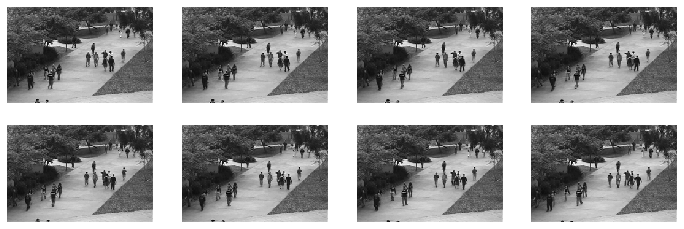

In [ ]:
# You can change the following train_sample_folder to another folder to view other clips
train_sample_folder = 'Train001' 
image_range = (1,9)  # this display image from 1 to 8
image_folder = os.path.join(train_dir, train_sample_folder)
display_images(image_folder, image_range=image_range, max_per_row=4)

In [ ]:
gif_filename = train_sample_folder + '.gif' 
create_gif(image_folder, gif_filename, img_type='tif')

Display the Train Video

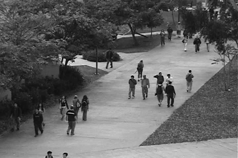

In [ ]:
with open(gif_filename,'rb') as file:
    display(ipyImage(file.read(), format='png'))

Visualize the Test Dataset

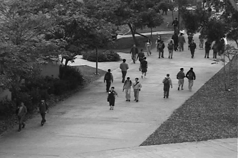

In [ ]:
# For now we use the UCSDped1 dataset.
base_dataset_dir = 'video_dataset'
dataset = 'UCSDped1'

# setup all the relative path
root_path = os.path.join(base_dataset_dir, dataset)
train_dir = os.path.join(root_path, 'Train')
test_dir = os.path.join(root_path, 'Test')

# set the test sample folder to folder of Test001 and set the image_folder accordingly
test_sample_folder = 'Test001' 
image_folder = os.path.join(test_dir, test_sample_folder) 

create_gif(image_folder, gif_filename, img_type='tif')

with open(gif_filename,'rb') as file:
    display(ipyImage(file.read(), format='png'))

그림 크기 확인

In [ ]:
dir_data = 'video_dataset/UCSDped1/Test/Test001'
fig_name = '001.tif'
img = Image.open(os.path.join(dir_data, fig_name))
print(img.size)

(238, 158)


In [ ]:
def make_train_file_list():

    train_img_list = list()

    for i in range(28):
        for j in range(200):
          if i < 9:
            if j < 9:
              img_path = 'video_dataset/UCSDped1/Train/' + 'Train00' + str(i+1) + '/' + '00' + str(j+1) + '.tif'
            elif j < 99:
              img_path = 'video_dataset/UCSDped1/Train/' + 'Train00' + str(i+1) + '/' + '0' + str(j+1) + '.tif'
            else:
              img_path = 'video_dataset/UCSDped1/Train/' + 'Train00' + str(i+1) + '/' + str(j+1) + '.tif'
          else:
            if j < 9:
              img_path = 'video_dataset/UCSDped1/Train/' + 'Train0' + str(i+1) + '/' + '00' + str(j+1) + '.tif'
            elif j < 99:
              img_path = 'video_dataset/UCSDped1/Train/' + 'Train0' + str(i+1) + '/' + '0' + str(j+1) + '.tif'
            else:
              img_path = 'video_dataset/UCSDped1/Train/' + 'Train0' + str(i+1) + '/' + str(j+1) + '.tif'
          train_img_list.append(img_path)    

    return train_img_list

def make_test_file_list():

    test_img_list = list()

    for i in range(36):
        for j in range(200):
          if i < 9:
            if j < 9:
              img_path = 'video_dataset/UCSDped1/Test/' + 'Test00' + str(i+1) + '/' + '00' + str(j+1) + '.tif'
            elif j < 99:
              img_path = 'video_dataset/UCSDped1/Test/' + 'Test00' + str(i+1) + '/' + '0' + str(j+1) + '.tif'
            else:
              img_path = 'video_dataset/UCSDped1/Test/' + 'Test00' + str(i+1) + '/' + str(j+1) + '.tif'
          else:
            if j < 9:
              img_path = 'video_dataset/UCSDped1/Test/' + 'Test0' + str(i+1) + '/' + '00' + str(j+1) + '.tif'
            elif j < 99:
              img_path = 'video_dataset/UCSDped1/Test/' + 'Test0' + str(i+1) + '/' + '0' + str(j+1) + '.tif'
            else:
              img_path = 'video_dataset/UCSDped1/Test/' + 'Test0' + str(i+1) + '/' + str(j+1) + '.tif'
          test_img_list.append(img_path)    

    return test_img_list

def make_val_file_list():

    val_img_list = list()

    for i in range(6):
        for j in range(200):
          if j < 9:
            img_path = 'video_dataset/UCSDped1/Validation/' + 'Val' + str(i+1) + '/' + '00' + str(j+1) + '.tif'
          elif j < 99:
            img_path = 'video_dataset/UCSDped1/Validation/' + 'Val' + str(i+1) + '/' + '0' + str(j+1) + '.tif'
          else:
            img_path = 'video_dataset/UCSDped1/Validation/' + 'Val' + str(i+1) + '/' + str(j+1) + '.tif'
          
          val_img_list.append(img_path)    

    return val_img_list

train_img_list=make_train_file_list()  
test_img_list=make_test_file_list()
val_img_list = make_val_file_list()

Maek train dataset, validation dataset, and test dataset

In [ ]:
class ImageTransform():

    def __init__(self, mean, std):
        self.data_transform = transforms.Compose([
            transforms.ToTensor(),
            transforms.Resize((200, 200))#,
#            transforms.Normalize(mean, std)
        ])

    def __call__(self, img):
        return self.data_transform(img)

print(len(train_img_list))

class Img_Dataset(data.Dataset):

    def __init__(self, file_list, transform):
        self.file_list = file_list
        self.transform = transform

    def __len__(self):
        return len(self.file_list)
        return len(img_transformed)

    def __getitem__(self, index):
        img_path = self.file_list[index]
        img = Image.open(img_path)
#        print("index and file name",index,img_path)
        img_transformed = self.transform(img)
#        print('hh',img_transformed.shape)

        return img_transformed

mean = (0.5,)
std = (0.3,)

train_dataset = Img_Dataset(file_list=train_img_list,
                            transform=ImageTransform(mean, std))
val_dataset = Img_Dataset(file_list=val_img_list,
                            transform=ImageTransform(mean, std))
test_dataset = Img_Dataset(file_list=test_img_list,
                            transform=ImageTransform(mean, std))

train_dataloader = torch.utils.data.DataLoader(train_dataset,
                                   batch_size=batch_size,
                                   shuffle=False)
val_dataloader = torch.utils.data.DataLoader(val_dataset,
                                   batch_size=batch_size,
                                   shuffle=False)
test_dataloader = torch.utils.data.DataLoader(test_dataset,
                                   batch_size=batch_size,
                                   shuffle=False)

print('train batches : %d' %(len(train_dataloader)))
print('test batches : %d' %(len(test_dataloader)))
print('validation batches : %d' %(len(val_dataloader)))

batch_iterator_tr = iter(train_dataloader)
images_tr = next(batch_iterator_tr)
print('tt',images_tr.size())       

batch_iterator_te = iter(test_dataloader)
images_te = next(batch_iterator_te)
print('ttt',images_te.size())       

batch_iterator_val = iter(val_dataloader)
images_val = next(batch_iterator_val)
print('tttt',images_val.size())     

#for i in range(200):
#  batch_iterator_val = iter(val_dataloader)
#  images_val = next(batch_iterator_val)
#  print('tttt',i, images_val.size()) 

5600
train batches : 350
test batches : 450
validation batches : 75
tt torch.Size([16, 1, 200, 200])
ttt torch.Size([16, 1, 200, 200])
tttt torch.Size([16, 1, 200, 200])


In [ ]:
215%199
215//199

1

In [ ]:
import os
import glob

import torch
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms

from PIL import Image

class MyDataset(Dataset):
    def __init__(self, image_paths, seq_length, transform): 
        self.image_paths = image_paths
        self.seq_length = seq_length
        self.transform = transform
      
    def __getitem__(self, index):
        file_pos = (index)%200
        file_pos2 = (index//200)*200
        if file_pos < (200 - seq_length+1):
          images =[]
          for i in range(self.seq_length):
            img_file = self.image_paths[index + i]
            img = Image.open(img_file)
#            print(index,img_file)
            img_transformed = self.transform(img)
            images.append(img_transformed)

          x=torch.cat(images, dim=0)
          return x
        else:
          images =[]
          for i in range(self.seq_length):
            img_file = self.image_paths[file_pos2 + i]
            img = Image.open(img_file)
#            print(index,img_file)
            img_transformed = self.transform(img)
            images.append(img_transformed)

          x=torch.cat(images, dim=0)
          return x


    def __len__(self):
        return len(self.image_paths)


#root_dir = './video_dataset/UCSDped1/Train/'
#class_paths = [d.path for d in os.scandir(root_dir) if d.is_dir]

#img_file_list = list()
#for i in range(len(class_paths)):
#  for j in range(200):
#    if j < 9:
#      img_file = class_paths[i] + '/00' + str(j+1) + '.tif'
#    elif j < 99:
#      img_file = class_paths[i] + '/0' + str(j+1) + '.tif'
#    else:
#      img_file = class_paths[i] + '/' + str(j+1) + '.tif'
#    img_file_list.append(img_file)        

#print(img_file_list) 

seq_length = 10

transform = transforms.Compose([
    transforms.Resize((200, 200)),
    transforms.ToTensor()
])

val_dataset = MyDataset(
    image_paths=val_img_list,
    seq_length=seq_length,
    transform=transform)

#print('mydataset',len(ddataset))
val_dataloader = DataLoader(
    val_dataset,
    batch_size=16,
    shuffle = False
)

train_dataset = MyDataset(
    image_paths=train_img_list,
    seq_length=seq_length,
    transform=transform)

#print('mydataset',len(ddataset))
train_dataloader = DataLoader(
    train_dataset,
    batch_size=16,
    shuffle = False
)

print('train batch size',len(train_dataloader))
train_batch_loader = iter(train_dataloader)
images_tr = next(train_batch_loader)
print('last',images_tr.shape)

print('validation batch size',len(val_dataloader))
val_batch_loader = iter(val_dataloader)
images_val = next(val_batch_loader)
print('last',images_val.shape)      


train batch size 350
last torch.Size([16, 10, 200, 200])
validation batch size 75
last torch.Size([16, 10, 200, 200])


Check the batch size

In [ ]:
print('Number of batches of train images = {}'.format(len(list(train_dataloader))))
print('Number of batches of validation images = {}'.format(len(list(val_dataloader))))

Number of batches of train images = 350
Number of batches of validation images = 75


Build the AutoEnoder Model with Pytorch


In [ ]:
class Conv_AE(torch.nn.Module):
    def __init__(self):
        super(Conv_AE, self).__init__()

        self.encoder = nn.Sequential(
             torch.nn.Conv2d(10, 512, kernel_size=5, stride=1, padding=2),  #(?,10,200,200) -> (?,512,200,200)
             torch.nn.ReLU(),
             torch.nn.MaxPool2d(kernel_size=2, stride=2),     # (?, 512, 200,200)  -> (?, 512, 100, 100)   
             torch.nn.Conv2d(512, 256, kernel_size=5, stride=1, padding=2), # (?, 512, 100, 100) -> (?, 256, 100, 100)
             torch.nn.ReLU(),
             torch.nn.MaxPool2d(kernel_size=2, stride=2),  # (?, 256, 100, 100) -> (?, 256, 50, 50)
             torch.nn.Conv2d(256, 128, kernel_size=5, stride=1, padding=2), # (?, 256, 50, 50) -> (?, 128, 50, 50)
             torch.nn.ReLU(),
             torch.nn.MaxPool2d(kernel_size=2, stride=2))  # (?, 128, 50, 50) -> (?, 128, 25, 25)
    

        self.latent1  = nn.Sequential(
             torch.nn.Linear(80000,2000))  

        self.latent2 = nn.Sequential(
             torch.nn.Linear(2000,80000),
             torch.nn.ReLU())        

        self.decoder = nn.Sequential(
              torch.nn.Upsample(scale_factor=2, mode ='nearest'),                       # (?, 128, 25, 25) -> (?, 128, 50, 50)
              torch.nn.ConvTranspose2d(128,256,kernel_size=5,stride=1, padding=2),        # (?, 128, 50, 50) -> (?, 256, 50, 50) 
              torch.nn.ReLU(),
              torch.nn.Upsample(scale_factor=2, mode ='nearest'),                       # (?, 256, 50, 50) -> (?, 256, 100, 100)
              torch.nn.ConvTranspose2d(256,512,kernel_size=5, stride=1, padding=2),       # (?, 256, 100, 100) -> (?, 512, 100, 100)
              torch.nn.ReLU(),
              torch.nn.Upsample(scale_factor=2, mode ='nearest'),                       # (?, 512, 100, 100) -> (?, 512, 200, 200) 
              torch.nn.ConvTranspose2d(512,10,kernel_size=5, stride=1, padding=2)         # (? ,512 ,200, 200) -> (?, 10, 200, 200)
       )



    def forward(self, x):
        out = self.encoder(x)
#        print(out.shape)
        out = out.view(out.size(0),-1)   # 전결합층을 위해서 Flatten
#        print('after flatten',out.shape)
        out = self.latent1(out)
#        print(out.shape)
        out = self.latent2(out)
#        print(out.shape)
        out = out.view(out.size(0),-1,25,25)         # -> (?, 32, 25,25)
#        print(out.shape)
        out = self.decoder(out)                     # -> (?, 32, 50, 50)
#        print('after decoder',out.shape)
#        out = self.decoder2(out)                     # -> (?, 32, 50, 50)
#        print(out.shape)
#        out = self.decoder3(out)
#        print(out.shape)
        return out

model = Conv_AE().to(device)

Loss, Optimizer 정의

In [ ]:
criterion = torch.nn.MSELoss().to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)
scheduler = optim.lr_scheduler.ExponentialLR(optimizer, 0.98739) 

Training

In [ ]:
validation_losses = []
training_losses = []
epoch_index = []
cnt = 0
for epoch in range(training_epochs + 1):
    # train
    batch_losses = []
    cnt = 0
    for x_batch in train_dataloader:
#         x_train = x_train.to(device)
#        y_train = y_train.to(device)
#        result = model(x_train)
#        optimizer.zero_grad()
#        loss = criterion(result, x_train)
#        loss.backward()
#        optimizer.step()
#        avg_loss += loss / len(train_dataset) # loss / 배치의 갯수
#    print('[Epoch: {:>4}] loss = {:>.9}'.format(epoch + 1, avg_loss))
        cnt += 1
#        print(cnt,x_batch.size())

        x_batch = x_batch.to(device)
        x_pred = model(x_batch)
        loss = criterion(x_pred, x_batch)
        batch_losses.append(loss.cpu().item())

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    training_loss = np.mean(batch_losses)
    training_losses.append(training_loss)

    # validation
    batch_losses = []

    with torch.no_grad():
        batch_val_losses = []

        for x_batch in val_dataloader:
            x_batch = x_batch.to(device)
            x_pred = model(x_batch)

            loss = criterion(x_pred, x_batch)
            batch_val_losses.append(loss.cpu().item())

        validation_loss = np.mean(batch_val_losses)
        validation_losses.append(validation_loss)

        if len(validation_losses) > 100:
            # Model checkpoint
            if validation_loss < min(validation_losses):
                print('The best model saved in model.h5.')
                torch.save(model.state_dict(), 'model.h5')

            # Early stopping
            # if validation_loss > min(validation_losses[-5:]):
            #    print('Early stopping!')
            #    break
            if validation_loss > min(validation_losses):
              cnt +=1
            else:
              cnt =0
            if cnt > 10:
              print("Early stopping")
              epoch_index.append(epoch)
              validation_losses.append(validation_loss)
              torch.save(model.state_dict(), 'model.h5')
              break    

    if epoch==training_epochs:
       torch.save(model.state_dict(), 'model.h5')


    print('Epoch: {:04d}, loss = {:.6f}, val_loss = {:.6f}'.format(epoch, training_loss, validation_loss))
    epoch_index.append(epoch)

Epoch: 0000, loss = 0.039460, val_loss = 0.037994
Epoch: 0001, loss = 0.039456, val_loss = 0.038003
Epoch: 0002, loss = 0.039455, val_loss = 0.038012
Epoch: 0003, loss = 0.039455, val_loss = 0.038018
Epoch: 0004, loss = 0.039454, val_loss = 0.038021
Epoch: 0005, loss = 0.039454, val_loss = 0.038023
Epoch: 0006, loss = 0.039454, val_loss = 0.038023
Epoch: 0007, loss = 0.039454, val_loss = 0.038022
Epoch: 0008, loss = 0.039454, val_loss = 0.038021
Epoch: 0009, loss = 0.039454, val_loss = 0.038020


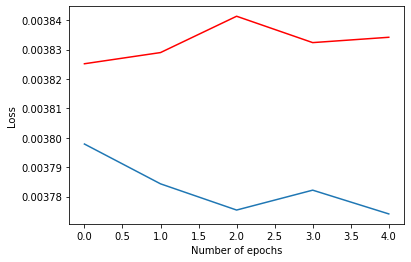

In [ ]:
n_train_losses = np.array(training_losses)
n_val_losses = np.array(validation_losses)
n_epoch = np.array(epoch_index)
plt.plot(n_epoch, n_train_losses,n_epoch,n_val_losses,'r')
plt.xlabel("Number of epochs")
plt.ylabel("Loss")
plt.show()



모델 저장

In [ ]:
torch.save(model, 'model.pt')

모델 로드

In [ ]:
model = torch.load('model.pt') 
model.load_state_dict(torch.load('model.h5'))  # 


<All keys matched successfully>

결과 확인

(238, 158)


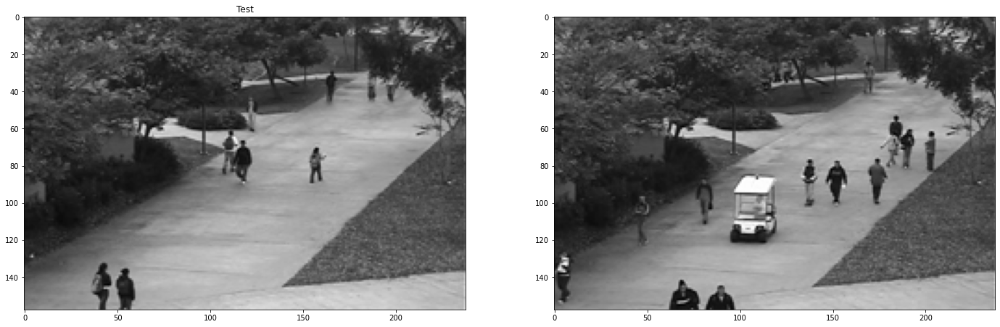

In [ ]:
from PIL import Image
train_folder_no = 20
train_file_no = 150
test_folder_no = 24
test_file_no = 140
train_file = 'video_dataset/UCSDped1/Train/Train0'+str(train_folder_no)+'/'+str(train_file_no)+'.tif'
test_file = 'video_dataset/UCSDped1/Test/Test0'+str(test_folder_no)+'/'+str(test_file_no)+'.tif'
train_image = Image.open(train_file)
test_image = Image.open(test_file)
print(train_image.size)
fig, axes = plt.subplots(1, 2, figsize=(24,8))
axes[0].set_title('Test')
axes[0].imshow(train_image,cmap=cm.gray)
axes[1].imshow(test_image,cmap=cm.gray)
plt.show()

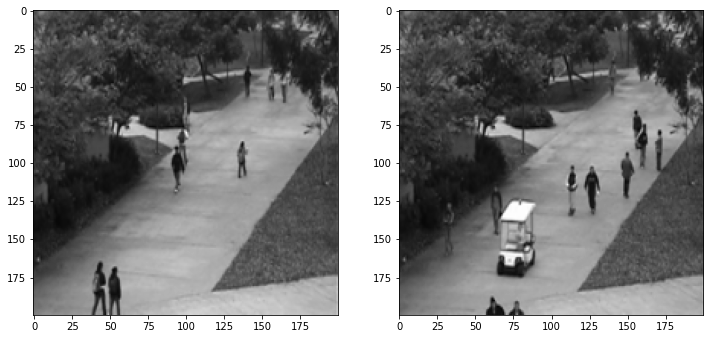

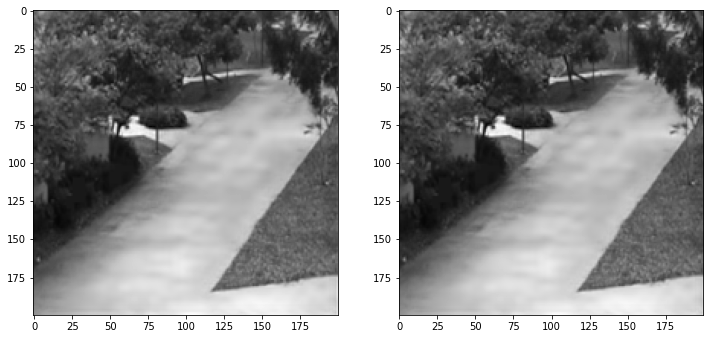

In [ ]:
train_input = ImageTransform(mean, std)(train_image)
test_input = ImageTransform(mean, std)(test_image)
train_input_image = train_input.permute(1,2,0).reshape(200,200)
test_input_image = test_input.permute(1,2,0).reshape(200,200)
fig, axes = plt.subplots(1, 2, figsize=(12,6))
axes[0].imshow(train_input_image,cmap=cm.gray)
axes[1].imshow(test_input_image,cmap=cm.gray)
plt.show()


train_images =[]
test_images = []
for i in range(10):
  train_file = train_file = 'video_dataset/UCSDped1/Train/Train0'+str(train_folder_no)+'/'+str(train_file_no+i)+'.tif'
  test_file = 'video_dataset/UCSDped1/Test/Test0'+str(test_folder_no)+'/'+str(test_file_no+i)+'.tif'
  train_image = Image.open(train_file)
  test_image = Image.open(test_file)
  train_input = ImageTransform(mean, std)(train_image)
  test_input = ImageTransform(mean, std)(test_image)
  train_images.append(train_input)
  test_images.append(test_input)
x_train = torch.cat(train_images, dim=0)
x_test = torch.cat(test_images, dim=0)  
test_batch = torch.stack([x_train, x_test])
test_batch = test_batch.to(device)
output = model(test_batch)

train_output = output[0,0, :, :]
test_output = output[1,0, :, :]


train_output_image = train_output.reshape(200,200).cpu().detach().numpy()
test_output_image = test_output.reshape(200,200).cpu().detach().numpy()

fig, axes = plt.subplots(1, 2, figsize=(12,6))
axes[0].imshow(train_output_image,cmap=cm.gray)
axes[1].imshow(test_output_image,cmap=cm.gray)
plt.show()










In [ ]:
time = []
for i in range(200):
  time.append(i+1)
time = np.array(time)

test_folder ='Test003'
test_list = []
for i in range(200):
  if i < 9:
    test_file_name = 'video_dataset/UCSDped1/Test/'+ test_folder +'/' + '00' + str(i+1) + '.tif'
  elif i < 99:
    test_file_name = 'video_dataset/UCSDped1/Test/'+ test_folder + '/' + '0' + str(i+1) + '.tif'
  else:
    test_file_name = 'video_dataset/UCSDped1/Test/'+ test_folder + '/' + str(i+1) + '.tif'    
  test_image = Image.open(test_file_name)
  test_input = ImageTransform(mean, std)(test_image)
  test_list.append(test_input)

test_input = torch.stack(test_list)
test_input = test_input.to(device)
test_output = model(test_input)
diff = (test_input - test_output)**2

#diff_data = np.array()
#print(diff.shape)
#for i in range(200):
#  diff_data[i] = diff[i, :, :]

#train_output_image = train_output.permute(1,2,0).reshape(100,100).cpu().detach().numpy()
#test_output_image = test_output.permute(1,2,0).reshape(100,100).cpu().detach().numpy()


diff_1 = diff.view(diff.size(0),-1)
diff_score = torch.sum(diff_1, axis=1)
diff_score = diff_score.cpu().detach().numpy()
max_diff_score = np.max(diff_score)
min_diff_score = np.min(diff_score)
ano_score = (diff_score - min_diff_score)/max_diff_score
  
#  print(ano_score.shape)
  
plt.plot(time, ano_score,'r')
plt.xlabel('Sequence')
plt.ylabel(test_folder)
plt.ylim(0, 1.0)
plt.show()

#

NameError: ignored

In [ ]:
!mkdir video_dataset/UCSDped1/Test_Diff
!mkdir video_dataset/UCSDped1/Test_Diff/Test003

In [ ]:
#!rm video_dataset/UCSDped1/Test_Diff/Test001/*

In [ ]:
for i in range(200):
  diff_img=diff[i,:,:,:]
  diff_img = diff_img.permute(1,2,0).cpu().detach().numpy()
  diff_img = diff_img.reshape(-1,200)
  diff_img = ((diff_img/np.max(diff_img))*256).astype(np.uint8)
  img_2 = Image.fromarray(diff_img) # NumPy array to PIL image
  if i < 9:
    img_2.save('video_dataset/UCSDped1/Test_Diff/'+test_folder+'/00'+str(i+1)+'.gif','GIF') # save PIL image
  elif i < 99:
    img_2.save('video_dataset/UCSDped1/Test_Diff/'+test_folder+'/0'+str(i+1)+'.gif','GIF') # save PIL image  
  else:
   img_2.save('video_dataset/UCSDped1/Test_Diff/'+test_folder + '/'+str(i+1)+'.gif','GIF') # save PIL image    

# For now we use the UCSDped1 dataset.
base_dataset_dir = 'video_dataset'
dataset = 'UCSDped1'

# setup all the relative path
root_path = os.path.join(base_dataset_dir, dataset)
test_dir = os.path.join(root_path, 'Test_Diff')

# set the test sample folder to folder of Test001 and set the image_folder accordingly
 
image_folder = os.path.join(test_dir, test_folder) 

create_gif(image_folder, gif_filename, img_type='gif')



# setup all the relative path
root_path = os.path.join(base_dataset_dir, dataset)
train_dir = os.path.join(root_path, 'Train')
test_dir = os.path.join(root_path, 'Test')

# set the test sample folder to folder of Test001 and set the image_folder accordingly
test_sample_folder = 'Test002' 
image_folder = os.path.join(test_dir, test_sample_folder) 
gif_filename_te = test_sample_folder + '.gif' 

create_gif(image_folder, gif_filename_te, img_type='tif')

with open(gif_filename,'rb') as file:
    display(ipyImage(file.read(), format='png'))

with open(gif_filename_te,'rb') as file:
    display(ipyImage(file.read(), format='png'))    

NameError: ignored

In [ ]:
# Ab
# type1: 자전거
# type2: 스케이트보드
# type3: 잔디밭침입
# type4: 트럭
# type5: 자동차
# type6: 휠체어
# type7: 전동차
# type8: 카트 
# type9: 뛰는사람

Ab_UCSDped1_Test001 = [] # Type 1
for i in range(200):
  if i < 76:
    Ab_UCSDped1_Test001.append(0)
  elif i < 148:
    Ab_UCSDped1_Test001.append(1)
  else:
    Ab_UCSDped1_Test001.append(0)
print(len(Ab_UCSDped1_Test001))

Ab_UCSDped1_Test002 = [] # Type 1
for i in range(200):
  if i < 60:
    Ab_UCSDped1_Test002.append(0)
  elif i < 147:
    Ab_UCSDped1_Test002.append(1)
  else:
    Ab_UCSDped1_Test002.append(0)

Ab_UCSDped1_Test003 = [] # Type 1
for i in range(200):
  if i < 88:
    Ab_UCSDped1_Test003.append(0)
  elif i < 199:
    Ab_UCSDped1_Test003.append(1)
  else:
    Ab_UCSDped1_Test003.append(0)

Ab_UCSDped1_Test004 = [] # Type 2
for i in range(200):
  if i < 31:
    Ab_UCSDped1_Test004.append(0)
  elif i < 164:
    Ab_UCSDped1_Test004.append(1)
  else:
    Ab_UCSDped1_Test004.append(0)

Ab_UCSDped1_Test005 = [] # type 1
for i in range(200):
  if i < 3:
    Ab_UCSDped1_Test005.append(0)
  elif i < 86:
    Ab_UCSDped1_Test005.append(1)
  elif i < 106:
    Ab_UCSDped1_Test005.append(0)
  elif i < 200:
    Ab_UCSDped1_Test005.append(1) 

Ab_UCSDped1_Test006 = [] # type 1, 2
for i in range(200):
  if i < 94:
    Ab_UCSDped1_Test006.append(1)
  elif i < 113:
    Ab_UCSDped1_Test006.append(0)
  else:
    Ab_UCSDped1_Test006.append(1)

Ab_UCSDped1_Test007 = [] # type 1, 2
for i in range(200):
  if i < 168:
    Ab_UCSDped1_Test007.append(1)
  else:
    Ab_UCSDped1_Test007.append(0) 

Ab_UCSDped1_Test008 = [] # Type 2
for i in range(200):
  if i < 88:
    Ab_UCSDped1_Test008.append(1)
  else:
    Ab_UCSDped1_Test008.append(0) 

Ab_UCSDped1_Test009 = [] # Type 3
for i in range(200):
  if i < 44:
    Ab_UCSDped1_Test009.append(1)
  else:
    Ab_UCSDped1_Test009.append(0) 

Ab_UCSDped1_Test010 = [] # 2
for i in range(200):
  if i < 119:
    Ab_UCSDped1_Test010.append(1)
  else:
    Ab_UCSDped1_Test010.append(0) 

Ab_UCSDped1_Test011 = [] # 3
for i in range(200):
  if i < 116:
    Ab_UCSDped1_Test011.append(0)
  elif i < 161:
    Ab_UCSDped1_Test011.append(1)
  else:
    Ab_UCSDped1_Test011.append(0)

Ab_UCSDped1_Test012 = [] # 2
for i in range(200):
  if i < 131:
    Ab_UCSDped1_Test012.append(0)
  else:
    Ab_UCSDped1_Test012.append(1) 

Ab_UCSDped1_Test013 = [] # 1, 10, 3
for i in range(200):
  if i < 160:
    Ab_UCSDped1_Test013.append(1)
  else:
    Ab_UCSDped1_Test013.append(0) 

Ab_UCSDped1_Test014 = [] # 3, 1, 4
for i in range(200):
  Ab_UCSDped1_Test014.append(1)

Ab_UCSDped1_Test015 = [] # 1
for i in range(200):
  if i < 139:
    Ab_UCSDped1_Test015.append(0)
  else:
    Ab_UCSDped1_Test015.append(1) 

Ab_UCSDped1_Test016 = [] # 1
for i in range(200):
  if i < 123:
    Ab_UCSDped1_Test016.append(0)
  else:
    Ab_UCSDped1_Test016.append(1) 

Ab_UCSDped1_Test017 = [] # 1
for i in range(200):
  if i < 42:
    Ab_UCSDped1_Test017.append(1)
  else:
    Ab_UCSDped1_Test017.append(0)

Ab_UCSDped1_Test018 = [] # 2, 3
for i in range(200):
  if i < 41:
    Ab_UCSDped1_Test018.append(0)
  elif i < 120:
    Ab_UCSDped1_Test018.append(1)
  elif i < 164:
    Ab_UCSDped1_Test018.append(0)
  elif i < 194:
    Ab_UCSDped1_Test018.append(1)
  else:
    Ab_UCSDped1_Test018.append(0)      

Ab_UCSDped1_Test019 = [] # 5
for i in range(200):
  if i < 54:
    Ab_UCSDped1_Test019.append(0)
  elif i < 138:
    Ab_UCSDped1_Test019.append(1)
  else:
    Ab_UCSDped1_Test019.append(0)

Ab_UCSDped1_Test020 = [] # 5
for i in range(200):
  if i < 45:
    Ab_UCSDped1_Test020.append(0)
  elif i < 168:
    Ab_UCSDped1_Test020.append(1)
  else:
    Ab_UCSDped1_Test020.append(0)

Ab_UCSDped1_Test021 = [] # 6
for i in range(200):
  if i < 30:
    Ab_UCSDped1_Test021.append(0)
  else:
    Ab_UCSDped1_Test021.append(1)

Ab_UCSDped1_Test022 = [] # 2, 3
for i in range(200):
  if i < 8:
    Ab_UCSDped1_Test022.append(0)
  elif i < 106:
    Ab_UCSDped1_Test022.append(1)
  elif i < 189:
    Ab_UCSDped1_Test022.append(0)
  else: 
    Ab_UCSDped1_Test022.append(1)
       
Ab_UCSDped1_Test023 = []
for i in range(200):
  if i < 7:
    Ab_UCSDped1_Test023.append(0)
  else: 
    Ab_UCSDped1_Test023.append(1) 

Ab_UCSDped1_Test024 = []
for i in range(200):
  if i < 41:
    Ab_UCSDped1_Test024.append(0)
  elif i < 170:
    Ab_UCSDped1_Test024.append(1)
  else: 
    Ab_UCSDped1_Test024.append(0)

Ab_UCSDped1_Test025 = []
for i in range(200):
  if i < 45:
    Ab_UCSDped1_Test025.append(0)
  elif i < 131:
    Ab_UCSDped1_Test025.append(1)
  else: 
    Ab_UCSDped1_Test025.append(0)

Ab_UCSDped1_Test026 = []
for i in range(200):
  if i <78:
    Ab_UCSDped1_Test026.append(0)
  else: 
    Ab_UCSDped1_Test026.append(1)

Ab_UCSDped1_Test027 = []
for i in range(200):
  if i < 9:
    Ab_UCSDped1_Test027.append(0)
  elif i < 121:
    Ab_UCSDped1_Test027.append(1)
  else: 
    Ab_UCSDped1_Test027.append(0)

Ab_UCSDped1_Test028 = []
for i in range(200):
  if i < 112:
    Ab_UCSDped1_Test028.append(0)
  else:
    Ab_UCSDped1_Test028.append(1)

Ab_UCSDped1_Test029 = []
for i in range(200):
  if i < 12:
    Ab_UCSDped1_Test029.append(1)
  elif i < 46:
    Ab_UCSDped1_Test029.append(0)
  elif i < 111: 
    Ab_UCSDped1_Test029.append(1)    
  else:
    Ab_UCSDped1_Test029.append(0) 

Ab_UCSDped1_Test030 = []
for i in range(200):
  if i < 176:
    Ab_UCSDped1_Test030.append(0)
  else:
    Ab_UCSDped1_Test030.append(1)

Ab_UCSDped1_Test031 = []
for i in range(200):
  if i < 154:
    Ab_UCSDped1_Test031.append(1)
  else:
    Ab_UCSDped1_Test031.append(0)

Ab_UCSDped1_Test032 = []
for i in range(200):
  if i < 52:
    Ab_UCSDped1_Test032.append(1)
  elif i < 65:
    Ab_UCSDped1_Test032.append(0)
  elif i < 115:
    Ab_UCSDped1_Test032.append(1)    
  else:
    Ab_UCSDped1_Test032.append(0)  

Ab_UCSDped1_Test033 = []
for i in range(200):
  if i < 32:
    Ab_UCSDped1_Test033.append(0)
  elif i < 164:
    Ab_UCSDped1_Test033.append(1)
  else: 
    Ab_UCSDped1_Test033.append(0)          

Ab_UCSDped1_Test034 = []
for i in range(200):
  if i < 8:
    Ab_UCSDped1_Test034.append(0)
  elif i < 110:
    Ab_UCSDped1_Test034.append(1)
  else: 
    Ab_UCSDped1_Test034.append(0)

Ab_UCSDped1_Test035 = []
for i in range(200):
  if i < 88:
    Ab_UCSDped1_Test035.append(0)
  else:
    Ab_UCSDped1_Test035.append(1)

Ab_UCSDped1_Test036 = []
for i in range(200):
  if i < 95:
    Ab_UCSDped1_Test036.append(0)
  else:
    Ab_UCSDped1_Test036.append(1)


200


(200,)
(200,)


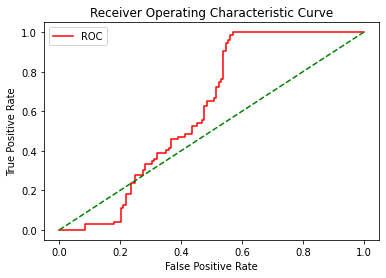

0.6091579861111112

In [ ]:
y = np.array(Ab_UCSDped1_Test001)
scores = ano_score
print(y.shape)
print(scores.shape)
fpr, tpr, thresholds = roc_curve(y, scores)
def plot_roc_curve(fper, tper):
    plt.plot(fper, tper, color='red', label='ROC')
    plt.plot([0, 1], [0, 1], color='green', linestyle='--')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('Receiver Operating Characteristic Curve')
    plt.legend()
    plt.show()

plot_roc_curve(fpr, tpr)
metrics.auc(fpr, tpr)